In [1]:
import pandas as pd
from lxml import etree
import requests

In [2]:
url = "https://www.hemnet.se/bostader/bbox"

params={
    'bbox':'59.247127100450335,17.76513093234948:59.35859632184681,18.403711254615104',
    'search_key':'57938136258b743b4bfb313c013169b07ef4cffd'
}

headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/56.0.2924.76 Safari/537.36'
}

payload = {}

response = requests.request("GET", url, headers=headers, data=payload, params=params)

In [11]:
response.json()['properties'][0]

{'id': 19280036,
 'coordinate': [59.3083229, 18.07769],
 'address': 'Ringvägen 127B, 3 tr',
 'location_name': 'Stockholms kommun',
 'typeSummary': 'Bostadsrättslägenhet',
 'iconName': 'bostadsratt',
 'project': False,
 'new_construction': False,
 'ongoing_bidding': False,
 'foreclosure': False,
 'upcoming': False,
 'price': '2\xa0875\xa0000\xa0kr',
 'price_per_area': '106\xa0481\xa0kr/m²',
 'has_price_change': False,
 'rooms': '1 rum',
 'fee': '1\xa0068\xa0kr/mån',
 'age_string': '<span>1</span> dagar',
 'age': 1,
 'deactivated_before_open_house': False,
 'living_space': {'table': {'living_area': '27 m²',
   'supplemental_area': None}},
 'land_area': None,
 'small_image_url': 'https://bilder.hemnet.se/images/itemgallery_S/92/53/9253576e5f129e87955d0fcf83890303.jpg',
 'medium_image_url': 'https://bilder.hemnet.se/images/itemgallery_M/92/53/9253576e5f129e87955d0fcf83890303.jpg',
 'url': 'https://www.hemnet.se/bostad/lagenhet-1rum-sodermalm-skanstull-stockholms-kommun-ringvagen-127b,-3-tr

In [7]:
df1=pd.json_normalize(response.json(),max_level=1,record_path='properties')
df1

,id,coordinate,address,location_name,typeSummary,iconName,project,new_construction,ongoing_bidding,foreclosure,...,broker_agency_name,locations_string,should_display_showings,should_highlight_showings,living_space.table,trackingData.listingId,trackingData.listingType,trackingData.listingPackageType,trackingData.listingState,trackingData.listingStatus
0,19280036,"[59.3083229, 18.07769]","Ringvägen 127B, 3 tr",Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Innerstadsspecialisten Stockholm AB,"Södermalm - Skanstull, Stockholms kommun",False,True,"{'living_area': '27 m²', 'supplemental_area': ...",19280036,common_listing,plus,active,for_sale
1,19279462,"[59.30951, 18.08396]","Ringvägen 153, 4 tr",Stockholms kommun,"Lägenhet, andel i bostadsförening",bostadsratt,False,False,False,False,...,Svensk Fastighetsförmedling Sthlm Södermalm,"Södermalm, Stockholms kommun",False,True,"{'living_area': '42 m²', 'supplemental_area': ...",19279462,common_listing,premium,active,for_sale
2,19261877,"[59.3096237, 18.0843124]","Ringvägen 155, 5 tr",Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Bjurfors Södermalm,"Södermalm Katarina, Stockholms kommun",False,True,"{'living_area': '35 m²', 'supplemental_area': ...",19261877,common_listing,plus,active,for_sale
3,19039660,"[59.3084679, 18.0789337]",Ringvägen 131B,Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Bjurfors Södermalm,"Södermalm Katarina, Stockholms kommun",False,False,"{'living_area': '36 m²', 'supplemental_area': ...",19039660,common_listing,basic,active,for_sale
4,19257077,"[59.309875, 18.085268]",Ringvägen 157,Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Fastighetsbyrån Stockholm - Södermalm,"Katarina, Stockholms kommun",False,True,"{'living_area': '64 m²', 'supplemental_area': ...",19257077,common_listing,premium,active,for_sale
5,19226516,"[59.3188273746, 18.0518373102]",Ringvägen 9 F,Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Fastighetsbyrån Stockholm - Södermalm,"Högalid, Stockholms kommun",False,False,"{'living_area': '74 m²', 'supplemental_area': ...",19226516,common_listing,premium,active,for_sale
6,19221316,"[59.308773, 18.06481]","Ringvägen 79, 2 tr",Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,True,False,...,Bjurfors Södermalm,"Södermalm Katarina, Stockholms kommun",False,False,"{'living_area': '109,4 m²', 'supplemental_area...",19221316,common_listing,basic,active,for_sale
7,18687869,"[59.3083572, 18.0818329]",Ringvägen 130,Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,MOHV Stockholm AB,"Södermalm, Stockholms kommun",False,False,"{'living_area': '21,5 m²', 'supplemental_area'...",18687869,common_listing,basic,active,for_sale
8,19039408,"[59.3084564, 18.06627]",Ringvägen 87A 3tr,Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Bjurfors Södermalm,"Södermalm Katarina, Stockholms kommun",False,False,"{'living_area': '47 m²', 'supplemental_area': ...",19039408,common_listing,premium,active,for_sale


In [20]:
df1[['id','address']]

,id,address
0,19280036,"Ringvägen 127B, 3 tr"
1,19279462,"Ringvägen 153, 4 tr"
2,19261877,"Ringvägen 155, 5 tr"
3,19039660,Ringvägen 131B
4,19257077,Ringvägen 157
5,19226516,Ringvägen 9 F
6,19221316,"Ringvägen 79, 2 tr"
7,18687869,Ringvägen 130
8,19039408,Ringvägen 87A 3tr


In [5]:
j=response.json()['properties']

In [6]:
df=pd.json_normalize(j, max_level=1)
#df.keys
df.head(3)

,id,coordinate,address,location_name,typeSummary,iconName,project,new_construction,ongoing_bidding,foreclosure,...,broker_agency_name,locations_string,should_display_showings,should_highlight_showings,living_space.table,trackingData.listingId,trackingData.listingType,trackingData.listingPackageType,trackingData.listingState,trackingData.listingStatus
0,19280036,"[59.3083229, 18.07769]","Ringvägen 127B, 3 tr",Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Innerstadsspecialisten Stockholm AB,"Södermalm - Skanstull, Stockholms kommun",False,True,"{'living_area': '27 m²', 'supplemental_area': ...",19280036,common_listing,plus,active,for_sale
1,19279462,"[59.30951, 18.08396]","Ringvägen 153, 4 tr",Stockholms kommun,"Lägenhet, andel i bostadsförening",bostadsratt,False,False,False,False,...,Svensk Fastighetsförmedling Sthlm Södermalm,"Södermalm, Stockholms kommun",False,True,"{'living_area': '42 m²', 'supplemental_area': ...",19279462,common_listing,premium,active,for_sale
2,19261877,"[59.3096237, 18.0843124]","Ringvägen 155, 5 tr",Stockholms kommun,Bostadsrättslägenhet,bostadsratt,False,False,False,False,...,Bjurfors Södermalm,"Södermalm Katarina, Stockholms kommun",False,True,"{'living_area': '35 m²', 'supplemental_area': ...",19261877,common_listing,plus,active,for_sale


In [5]:
#call graphql directly from listing with ids - example with one id only but can set into a loop
ql_id=df.iloc[1]['id']
ql_id

19279462

In [6]:
url_ql = "https://www.hemnet.se/graphql"

#would love to have payload_ql string formatted better but not really sure how without breaking it
payload_ql="{\"query\":\"query imagesForListing($id: ID!) {\\r\\n    listing(id: $id) \\r\\n    {  id  __typename  streetAddress  isSaved  brokerAgency \\r\\n    {    name    id    brokerCustomization \\r\\n    {      compactLogoUrl      largeLogoUrl: logoUrl(format: BROKER_CUSTOMIZATION_LARGE)      __typename    \\r\\n    }    __typename  }  ... on ActivePropertyListing \\r\\n    {    liveStreams(scope: ENDED) \\r\\n    {      embedUrl      __typename    \\r\\n    }    videoAttachment: attachment(type: VIDEO) \\r\\n    {      id      attachmentType      ... on VideoAttachment {     videoHemnetUrl        __typename     }\\r\\n          __typename    \\r\\n    }    threeDAttachment: attachment(type: THREE_D) {\\r\\n              id      ... on ThreeDAttachment {\\r\\n                          url        __typename      \\r\\n                          }      __typename    }\\r\\n                              isForeclosure    listingBrokerGalleryUrl    images(limit: 500) {\\r\\n                                        images {\\r\\n                                                    url(format: ITEMGALLERY_CUT)        portraitUrl: url(format: ITEMGALLERY_PORTRAIT_CUT)        fullscreenUrl: url(format: WIDTH1024)        originalHeight        originalWidth        labels        __typename      }      __typename    }    __typename  }  ... on ProjectUnit {    liveStreams(scope: ENDED) {      embedUrl      __typename    }    videoAttachment: attachment(type: VIDEO) {      id      attachmentType      ... on VideoAttachment {        videoHemnetUrl        __typename      }      __typename    }    threeDAttachment: attachment(type: THREE_D) {      id      ... on ThreeDAttachment {        url        __typename      }      __typename    }    isForeclosure    listingBrokerGalleryUrl    images(limit: 500) {      images {        url(format: ITEMGALLERY_CUT)        portraitUrl: url(format: ITEMGALLERY_PORTRAIT_CUT)        fullscreenUrl: url(format: WIDTH1024)        originalHeight        originalWidth        labels        __typename      }      __typename    }    __typename  }\\r\\n    }\\r\\n    }\",\"variables\":{\"id\":"+str(ql_id)+"}}"

headers_ql = {
  'Content-Type': 'application/json',
  'User-Agent': 'Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/56.0.2924.76 Safari/537.36'
}

response_ql = requests.request("POST", url_ql, headers=headers_ql, data=payload_ql)

#print(response_ql.text)
ql_path=response_ql.json()['data']['listing']['images']['images']

ql_df=pd.json_normalize(ql_path)
#ql_df

#print all images from listing item
from IPython.display import Image
for index,row in ql_df.iterrows():
   display(Image(url=row['url']))

In [9]:
#this lot should be cleared up a bit...

from math import ceil, floor, sqrt
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import numpy as np
from PIL import Image
from io import BytesIO

img_arr = []

#loop thru images from urls
for index,row in ql_df.iterrows():
    response = requests.get(row['url'], headers=headers_ql)
    im = Image.open(BytesIO(response.content))
    ni=np.asarray(im)
    img_arr.append(ni)
    w=im.width
    h=im.height


#calculate grid
N=len(img_arr)
x=floor(sqrt(N))
y=ceil(N/x)
print(x,y,h,w)

7 9 460 690


In [10]:
#make some blank images to fill up the last in the grid
for j in range(y*x-N):
    image = Image.new('RGB', (w,h),color=(255,255,255))
    ni=np.asarray(image)
    img_arr.append(ni)

In [11]:
#px = 1/plt.rcParams['figure.dpi']  # pixel in inches
px = 1/72. #jup notebooks 72dpi
px

0.013888888888888888

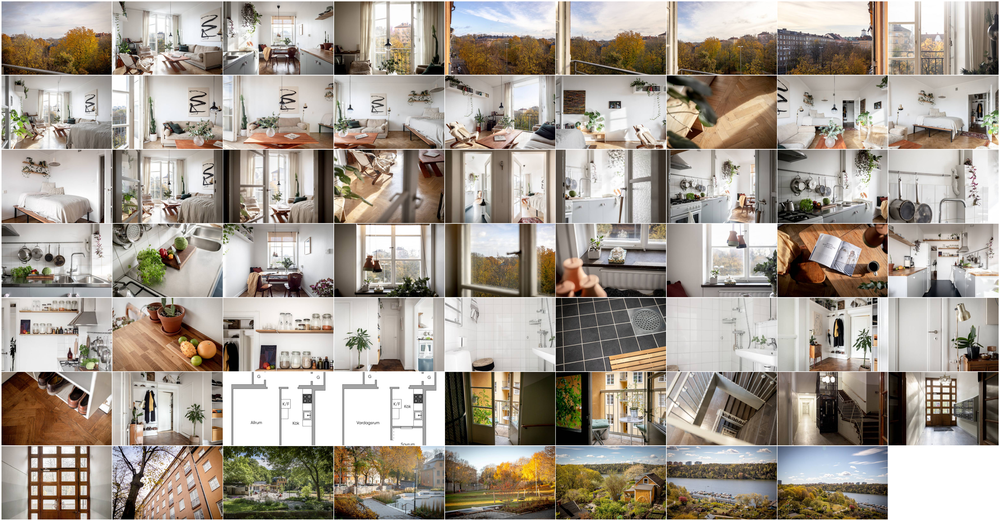

In [12]:
fig = plt.figure(figsize=(px*w*y,px*h*x))

grid = ImageGrid(fig, 111, 
                 nrows_ncols=(x, y),  # creates grid
                 axes_pad=0.045,  # pad
                 )

for ax, im in zip(grid, img_arr):
    ax.imshow(im)
    ax.axis('off')